# CS 5814 Homework 4, Part 1: Generative Adversarial Networks

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

Matplotlib created a temporary config/cache directory at /localscratch-ssd/269887/matplotlib-z1nhvqjf because the default path (/home/jovyan/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [2]:
%pip install torchvision

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 6.9 MB 3.3 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [2]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [2]:
import os
cwd = os.getcwd()

In [4]:
cwd

'/home/stanleygabriel97/cs5814/hw4/part1'

In [3]:
import os
datadir = "./part1/" # path to the homework
if not os.path.exists(cwd):
  !ln -s "" $datadir # path to the homework
os.chdir(cwd)
!pwd

/home/stanleygabriel97/cs5814/hw4/part1


In [4]:
from gan.train import train

In [5]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

In [6]:
device

device(type='cuda', index=0)

# GAN loss functions

You'll need to implement two different loss functions. The first is the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). The next is the loss from [LS-GAN](https://arxiv.org/abs/1611.04076).

### GAN loss

**TODO:** You need to implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$

Note that these equations are negated because we will be *minimizing* these losses.

**HINTS**: Use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss.

We will be averaging over the elements of the minibatch instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$.

In [9]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** You need to implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

[Least Squares GAN](https://arxiv.org/abs/1611.04076) is an alernative to the original GAN loss function.
For this part, all you need to do change the loss function and retrain the model.

Specifically, you'll implement equation (9) in the paper:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$

In [8]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Next, you'll need to implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We'll be using the architecture from [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

You can either use LeakyReLu throughout the discriminator (and a negative slope value of 0.2) or just use relu.

The discriminator will output a single score for each sample.The output of your discriminator should be a single value score corresponding to each input sample.


**Generator:**

**Note:** Here, you'll need to use transposed convolution (sometimes known as fractionally-strided convolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The generator network will need to map the output values between -1 and 1 using a `tanh` nonlinearity. The output should be of size 64x64 with 3 channels for each sample (equal dimensions to the images from the dataset).

In [11]:
from gan.models import Discriminator, Generator

# Data loading

Our dataset is pretty small, so in order to prevent overfitting, we need to perform data augmentation.

**TODO:** You'll need to implement some data augmentation by adding new transforms to the cell below.

The easiest you can do is just use the RandomCrop and ColorJitter, but feel free to play around with other augmentations as well to see how it affects the performance of your model. See https://pytorch.org/vision/stable/transforms.html.

In [12]:
batch_size = 32
imsize = 64
cat_root = './cats'

# Define your transformations
transform_augment = transforms.Compose([
    transforms.Resize((imsize, imsize)), # Ensures all images are the same size
    transforms.RandomCrop(imsize, padding=4),  # Pads and then crops
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(15),
    transforms.ToTensor(),  # Converts to tensor
])

# Create your ImageFolder dataset
cat_train = ImageFolder(root=cat_root, transform=transform_augment)

# Create DataLoader
cat_loader_train = DataLoader(cat_train, batch_size=batch_size, shuffle=True, drop_last=True)

### Visualize dataset

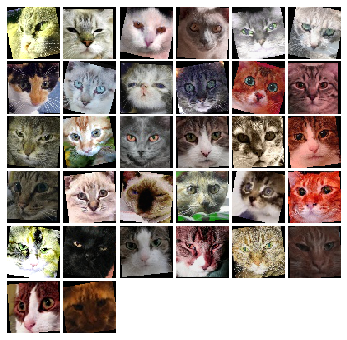

In [13]:
from gan.utils import show_images

# imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()
# show_images(imgs, color=True)

iterator = iter(cat_loader_train)

# Retrieve the next batch of images
imgs, _ = next(iterator)

# Convert images to a numpy array and adjust dimensions if needed
imgs = imgs.numpy().squeeze()

# Show the images using your custom function
show_images(imgs, color=True)

# Training


**TODO:** You need to write the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

### Train GAN

In [15]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [16]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.599, G:20.29


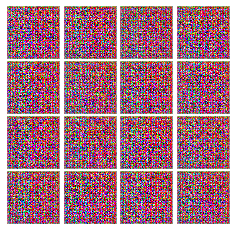


Iter: 250, D: 1.804, G:3.122


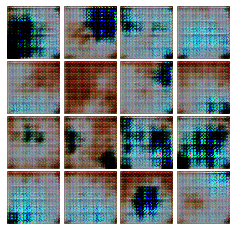


EPOCH:  2
Iter: 500, D: 0.9678, G:1.69


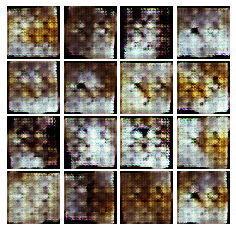


Iter: 750, D: 1.511, G:2.138


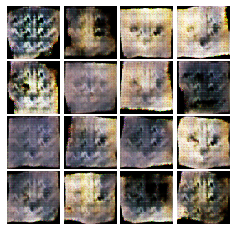


EPOCH:  3
Iter: 1000, D: 2.06, G:2.857


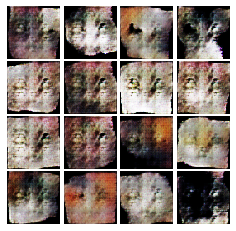


Iter: 1250, D: 1.23, G:1.966


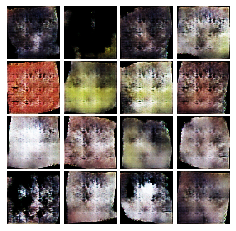


EPOCH:  4
Iter: 1500, D: 0.9543, G:3.061


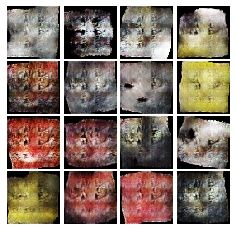


Iter: 1750, D: 1.404, G:3.676


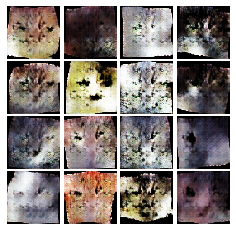


EPOCH:  5
Iter: 2000, D: 0.8647, G:2.65


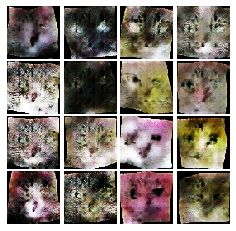


Iter: 2250, D: 1.38, G:4.278


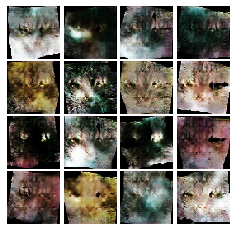


EPOCH:  6
Iter: 2500, D: 0.92, G:1.623


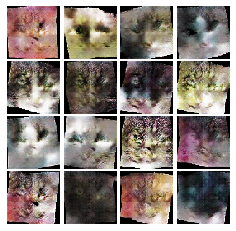


Iter: 2750, D: 1.156, G:3.927


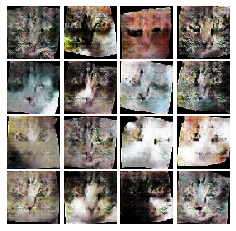


EPOCH:  7
Iter: 3000, D: 1.164, G:3.988


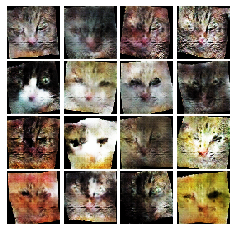


Iter: 3250, D: 0.7253, G:3.266


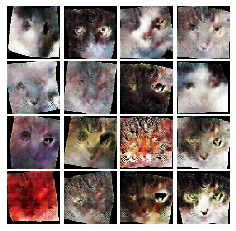


EPOCH:  8
Iter: 3500, D: 0.9552, G:2.666


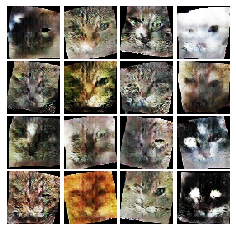


Iter: 3750, D: 1.094, G:2.328


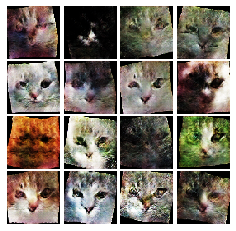


EPOCH:  9
Iter: 4000, D: 1.064, G:6.669


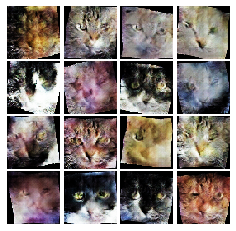


Iter: 4250, D: 0.5479, G:4.5


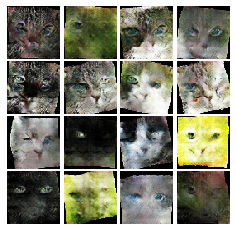


EPOCH:  10
Iter: 4500, D: 0.6745, G:3.513


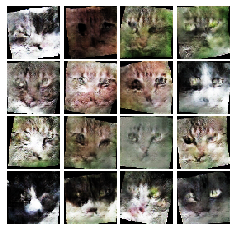


Iter: 4750, D: 1.272, G:6.96


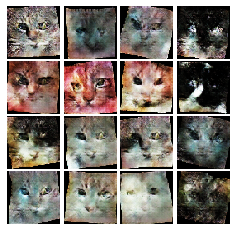


EPOCH:  11
Iter: 5000, D: 0.4872, G:6.017


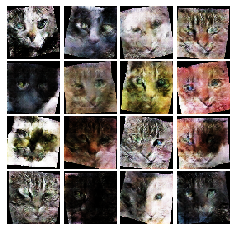


Iter: 5250, D: 1.117, G:2.043


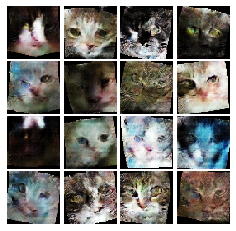


EPOCH:  12
Iter: 5500, D: 0.4743, G:2.649


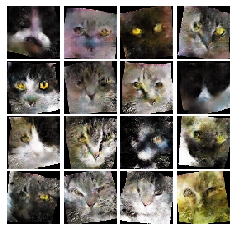


Iter: 5750, D: 0.4412, G:5.979


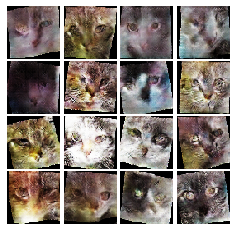


EPOCH:  13
Iter: 6000, D: 0.411, G:5.866


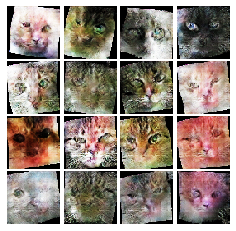


Iter: 6250, D: 2.205, G:9.649


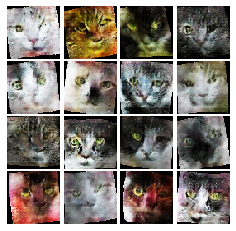


EPOCH:  14
Iter: 6500, D: 0.9214, G:6.545


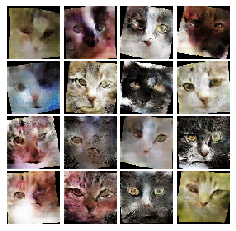


Iter: 6750, D: 0.5774, G:4.082


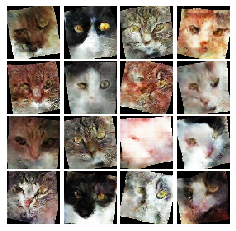


EPOCH:  15
Iter: 7000, D: 0.2787, G:3.172


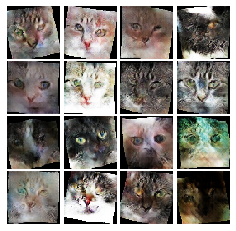


Iter: 7250, D: 0.7785, G:5.954


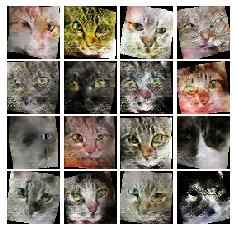


EPOCH:  16
Iter: 7500, D: 0.3788, G:5.463


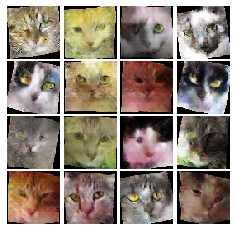


Iter: 7750, D: 0.5236, G:8.352


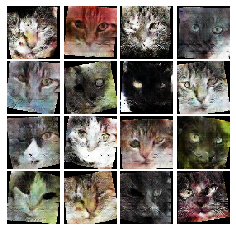


EPOCH:  17
Iter: 8000, D: 0.3434, G:5.098


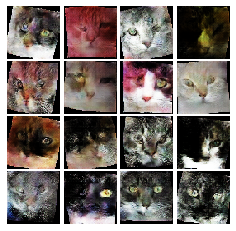


Iter: 8250, D: 0.9752, G:2.56


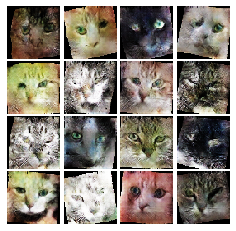


EPOCH:  18
Iter: 8500, D: 0.258, G:2.516


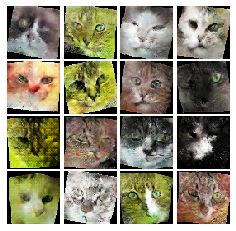


Iter: 8750, D: 0.2777, G:7.042


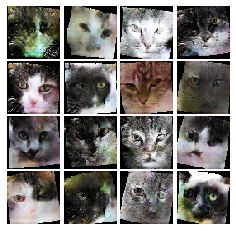


EPOCH:  19
Iter: 9000, D: 0.6008, G:5.79


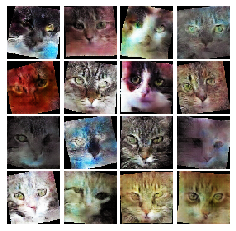


Iter: 9250, D: 0.1373, G:4.924


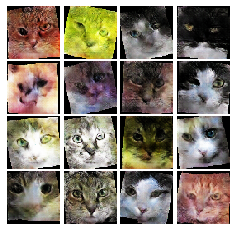


EPOCH:  20
Iter: 9500, D: 0.1932, G:6.17


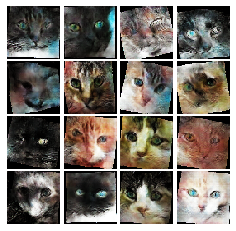


Iter: 9750, D: 0.1168, G:6.732


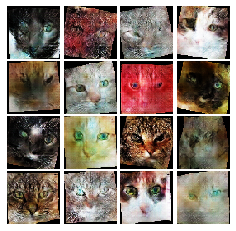


EPOCH:  21
Iter: 10000, D: 0.4121, G:4.298


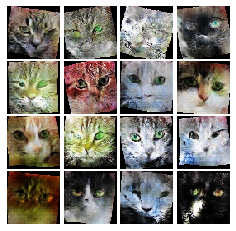


Iter: 10250, D: 0.3045, G:6.88


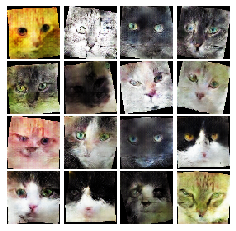


EPOCH:  22
Iter: 10500, D: 0.7204, G:11.18


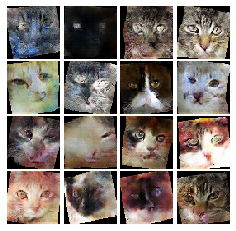


Iter: 10750, D: 0.255, G:4.567


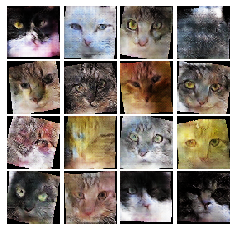


EPOCH:  23
Iter: 11000, D: 0.6078, G:4.562


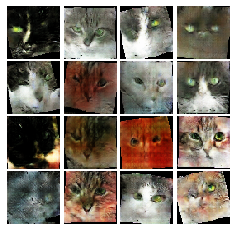


Iter: 11250, D: 0.06952, G:5.697


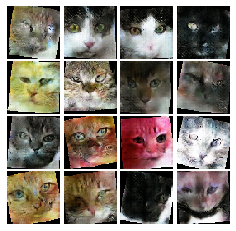


EPOCH:  24
Iter: 11500, D: 0.5455, G:11.6


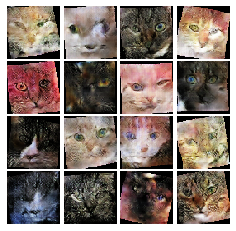


Iter: 11750, D: 0.491, G:4.758


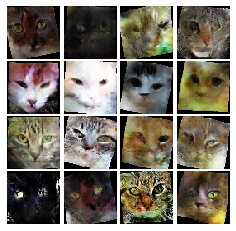


EPOCH:  25
Iter: 12000, D: 0.1571, G:4.957


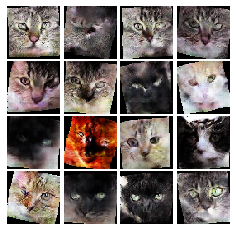


Iter: 12250, D: 0.3414, G:7.911


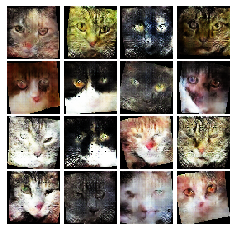


EPOCH:  26
Iter: 12500, D: 0.1947, G:4.402


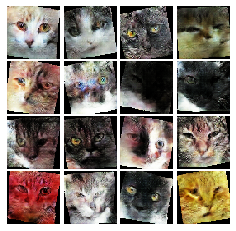


Iter: 12750, D: 0.6544, G:9.908


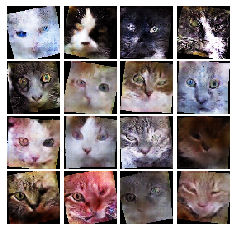


EPOCH:  27
Iter: 13000, D: 0.463, G:8.379


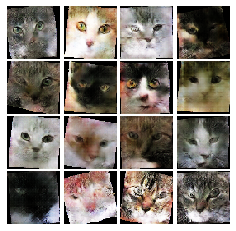


Iter: 13250, D: 0.2873, G:8.363


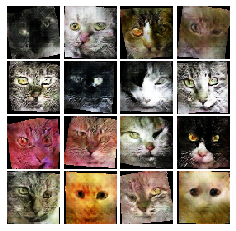


EPOCH:  28
Iter: 13500, D: 0.1504, G:5.214


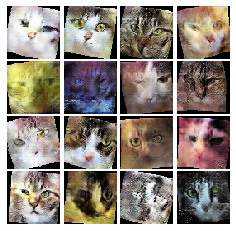


Iter: 13750, D: 0.4637, G:5.898


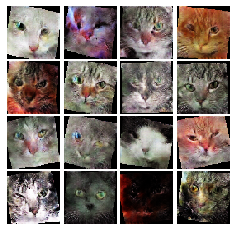


EPOCH:  29
Iter: 14000, D: 1.191, G:6.857


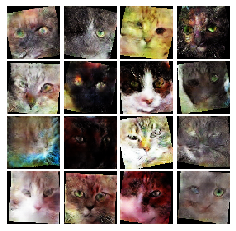


Iter: 14250, D: 0.01045, G:4.691


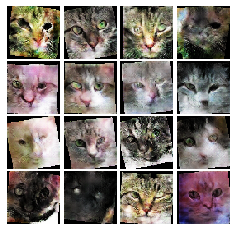


EPOCH:  30
Iter: 14500, D: 0.03837, G:10.59


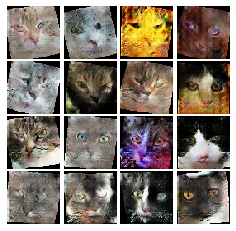


Iter: 14750, D: 0.04472, G:6.478


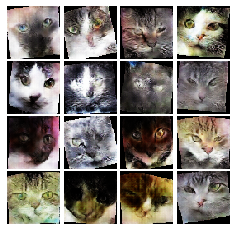


EPOCH:  31
Iter: 15000, D: 0.12, G:9.663


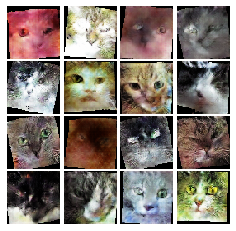


Iter: 15250, D: 0.3249, G:10.83


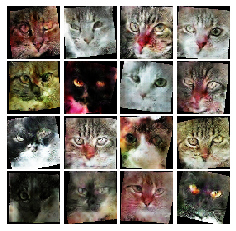


EPOCH:  32
Iter: 15500, D: 0.07516, G:6.481


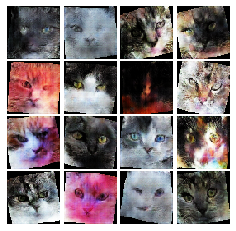


EPOCH:  33
Iter: 15750, D: 0.5399, G:4.734


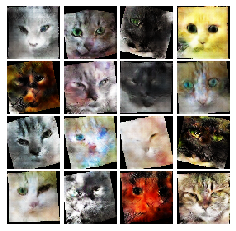


Iter: 16000, D: 0.3205, G:5.731


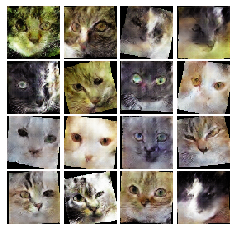


EPOCH:  34
Iter: 16250, D: 0.3923, G:4.767


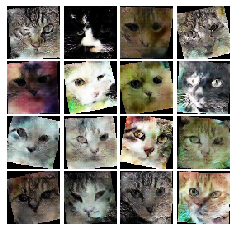


Iter: 16500, D: 0.05551, G:6.74


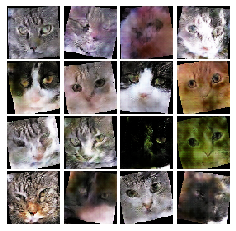


EPOCH:  35
Iter: 16750, D: 1.057, G:13.49


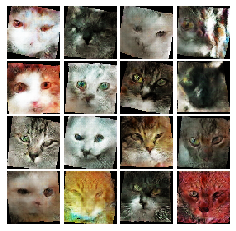


Iter: 17000, D: 0.02223, G:7.631


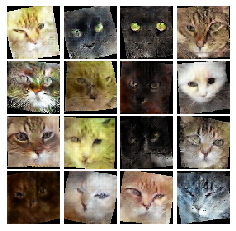


EPOCH:  36
Iter: 17250, D: 0.4059, G:1.312


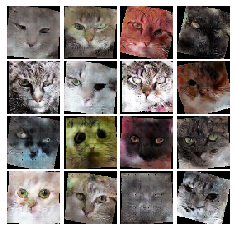


Iter: 17500, D: 0.03581, G:5.871


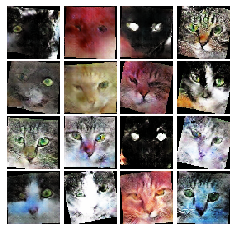


EPOCH:  37
Iter: 17750, D: 0.09553, G:6.964


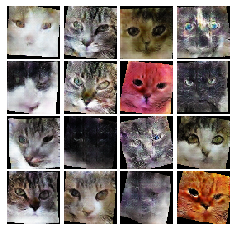


Iter: 18000, D: 0.4248, G:3.366


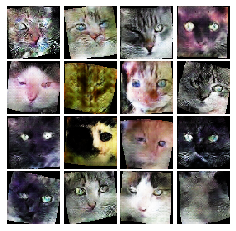


EPOCH:  38
Iter: 18250, D: 0.02623, G:9.048


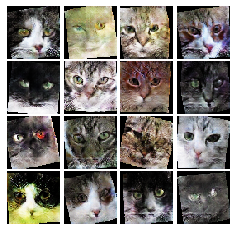


Iter: 18500, D: 0.03237, G:7.765


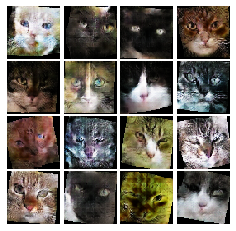


EPOCH:  39
Iter: 18750, D: 0.4137, G:7.874


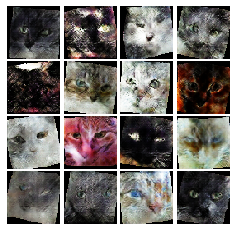


Iter: 19000, D: 0.06766, G:4.92


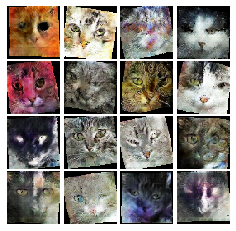


EPOCH:  40
Iter: 19250, D: 0.02517, G:7.243


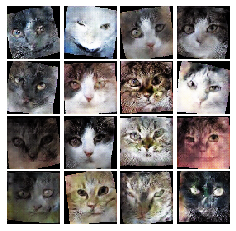


Iter: 19500, D: 0.2871, G:8.205


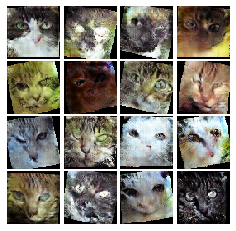


EPOCH:  41
Iter: 19750, D: 0.03226, G:7.321


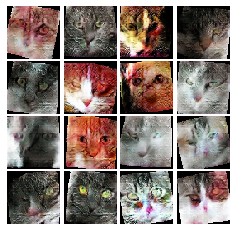


Iter: 20000, D: 0.1127, G:5.256


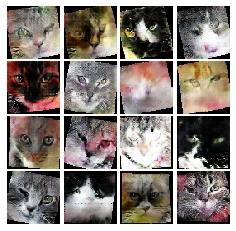


EPOCH:  42
Iter: 20250, D: 0.1015, G:6.88


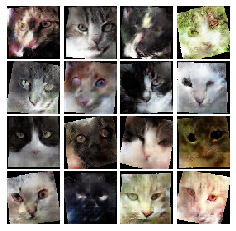


Iter: 20500, D: 0.1328, G:6.401


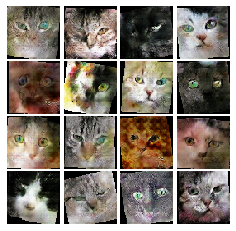


EPOCH:  43
Iter: 20750, D: 0.1228, G:9.559


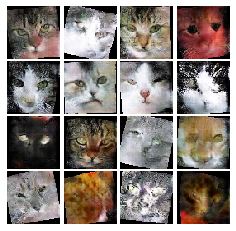


Iter: 21000, D: 0.02144, G:7.819


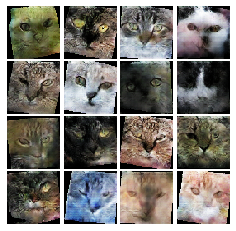


EPOCH:  44
Iter: 21250, D: 0.05761, G:7.645


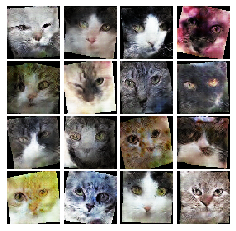


Iter: 21500, D: 0.009245, G:8.117


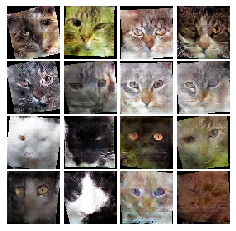


EPOCH:  45
Iter: 21750, D: 0.05172, G:7.449


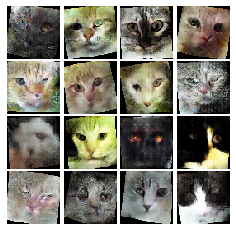


Iter: 22000, D: 1.405, G:18.52


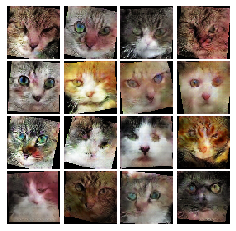


EPOCH:  46
Iter: 22250, D: 0.01924, G:8.596


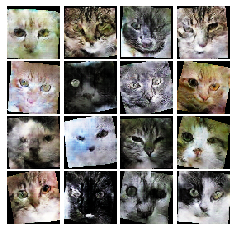


Iter: 22500, D: 0.5585, G:2.236


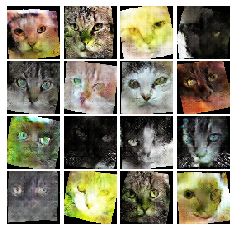


EPOCH:  47
Iter: 22750, D: 0.002744, G:9.638


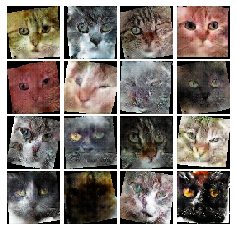


Iter: 23000, D: 0.06636, G:9.28


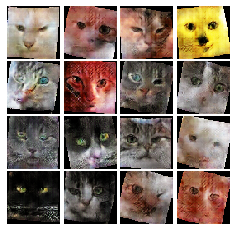


EPOCH:  48
Iter: 23250, D: 0.1332, G:9.54


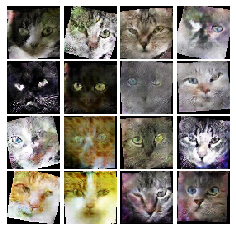


Iter: 23500, D: 0.09371, G:6.909


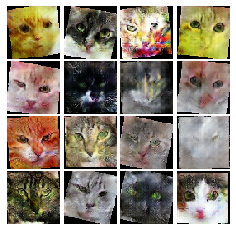


EPOCH:  49
Iter: 23750, D: 0.08482, G:6.739


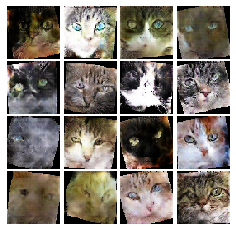


Iter: 24000, D: 0.04712, G:7.51


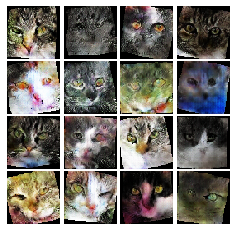


EPOCH:  50
Iter: 24250, D: 0.02576, G:8.315


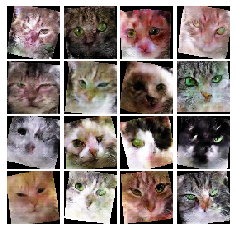


Iter: 24500, D: 0.03302, G:8.519


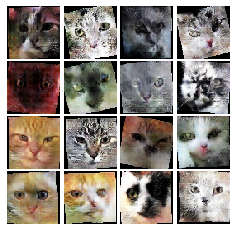

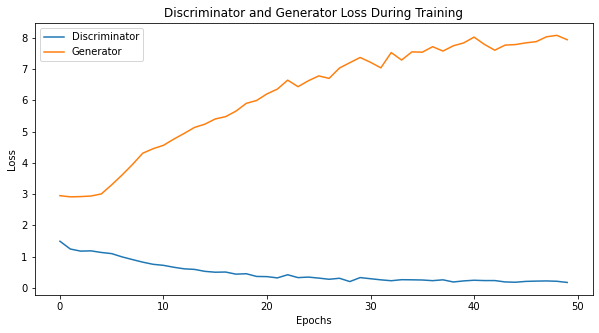

In [17]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

### Train LS-GAN

In [21]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [22]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.8897, G:226.8


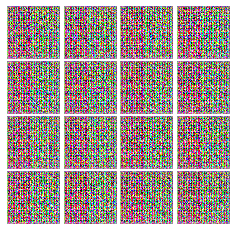


Iter: 250, D: 0.2178, G:0.3634


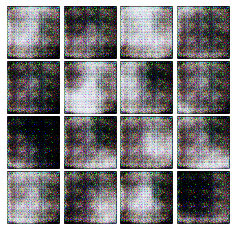


EPOCH:  2
Iter: 500, D: 0.207, G:0.5141


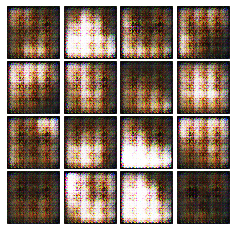


Iter: 750, D: 0.1716, G:0.6371


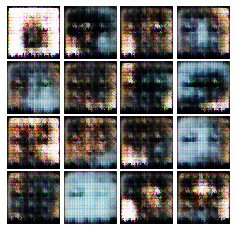


EPOCH:  3
Iter: 1000, D: 2.867, G:6.122


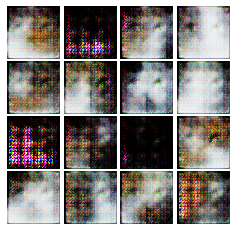


Iter: 1250, D: 0.09693, G:0.3331


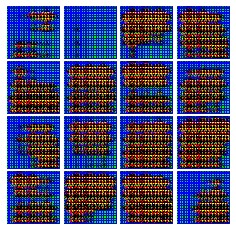


EPOCH:  4
Iter: 1500, D: 0.0517, G:0.494


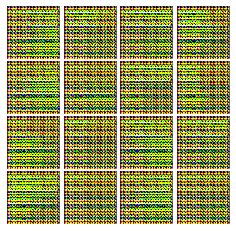


Iter: 1750, D: 0.05797, G:0.5012


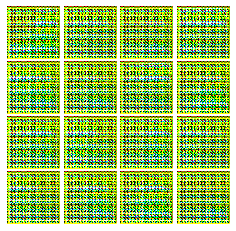


EPOCH:  5
Iter: 2000, D: 0.1468, G:0.7611


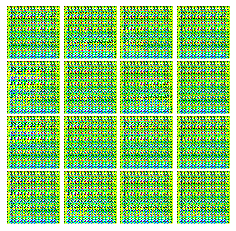


Iter: 2250, D: 0.1335, G:1.069


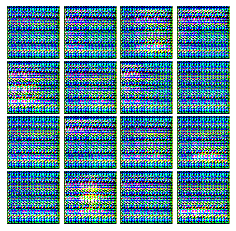


EPOCH:  6
Iter: 2500, D: 0.3175, G:0.3994


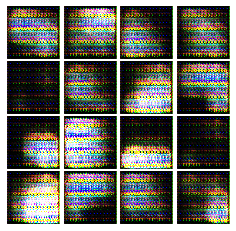


Iter: 2750, D: 1.111, G:1.415


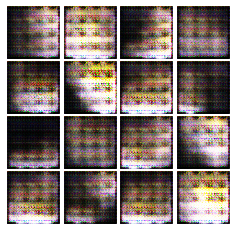


EPOCH:  7
Iter: 3000, D: 0.3653, G:0.3812


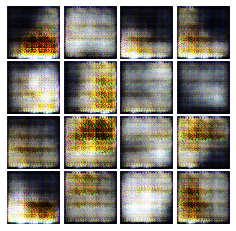


Iter: 3250, D: 0.1099, G:0.3393


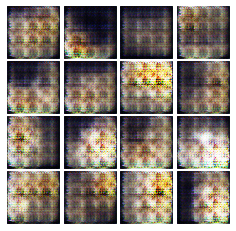


EPOCH:  8
Iter: 3500, D: 1.407, G:0.6529


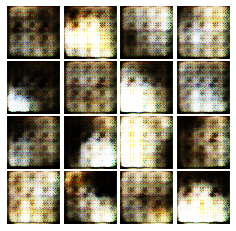


Iter: 3750, D: 0.5613, G:0.9716


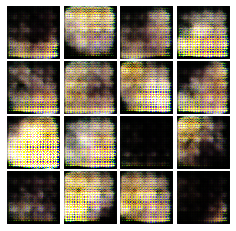


EPOCH:  9
Iter: 4000, D: 0.6849, G:0.1107


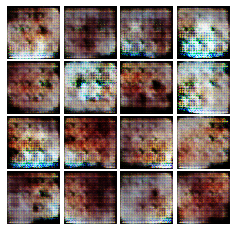


Iter: 4250, D: 0.4865, G:0.4009


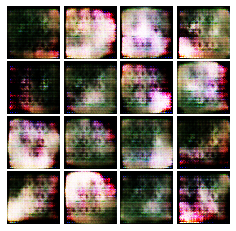


EPOCH:  10
Iter: 4500, D: 0.2101, G:0.3019


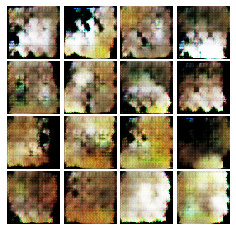


Iter: 4750, D: 0.1783, G:0.2811


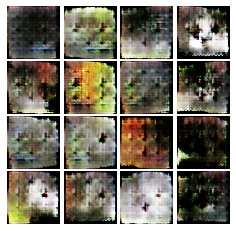


EPOCH:  11
Iter: 5000, D: 0.548, G:0.323


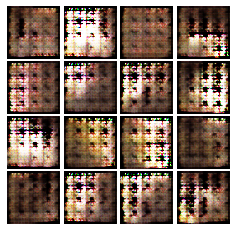


Iter: 5250, D: 0.1335, G:0.3821


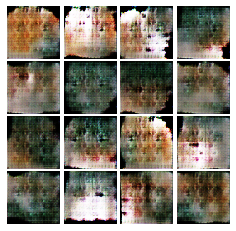


EPOCH:  12
Iter: 5500, D: 0.222, G:0.7429


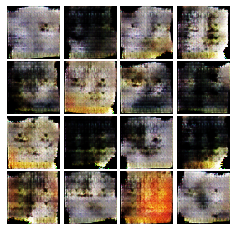


Iter: 5750, D: 0.2682, G:0.5003


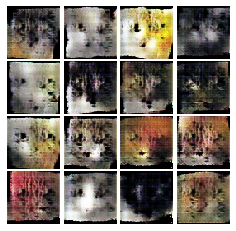


EPOCH:  13
Iter: 6000, D: 0.3426, G:0.2287


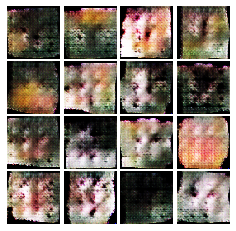


Iter: 6250, D: 0.1053, G:0.4178


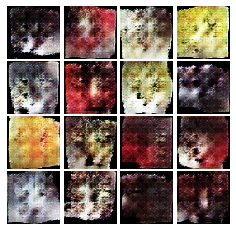


EPOCH:  14
Iter: 6500, D: 0.39, G:0.409


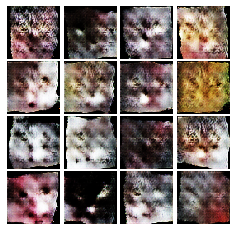


Iter: 6750, D: 0.4301, G:0.3337


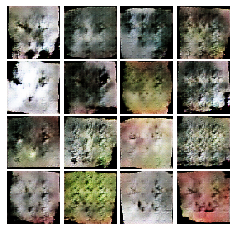


EPOCH:  15
Iter: 7000, D: 0.3623, G:0.4469


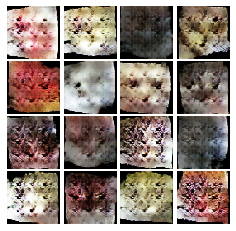


Iter: 7250, D: 0.3495, G:0.2469


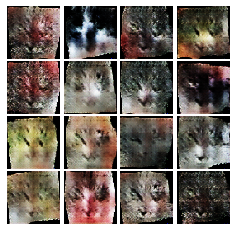


EPOCH:  16
Iter: 7500, D: 0.5875, G:0.9614


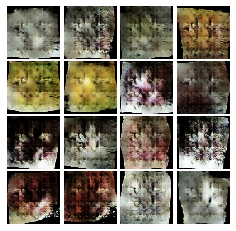


Iter: 7750, D: 0.2966, G:0.4886


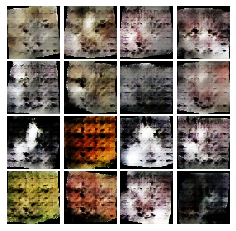


EPOCH:  17
Iter: 8000, D: 0.8426, G:0.7168


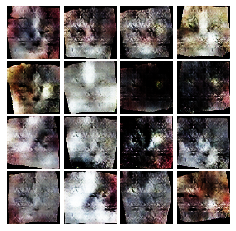


Iter: 8250, D: 0.2173, G:0.2792


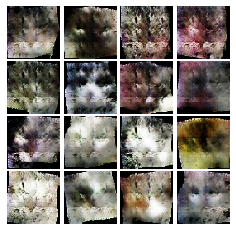


EPOCH:  18
Iter: 8500, D: 0.4457, G:0.8339


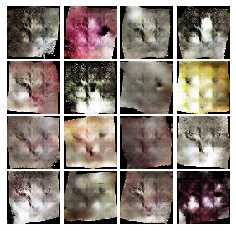


Iter: 8750, D: 0.2825, G:0.4984


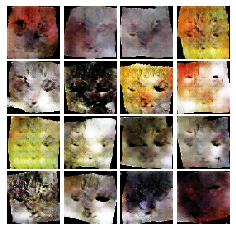


EPOCH:  19
Iter: 9000, D: 0.3061, G:0.3208


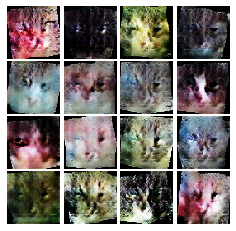


Iter: 9250, D: 0.3014, G:0.3174


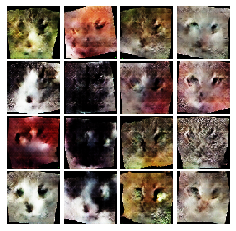


EPOCH:  20
Iter: 9500, D: 0.3595, G:0.2257


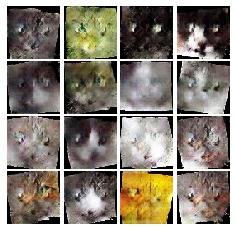


Iter: 9750, D: 0.2045, G:0.2784


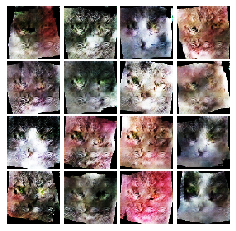


EPOCH:  21
Iter: 10000, D: 0.1774, G:0.3245


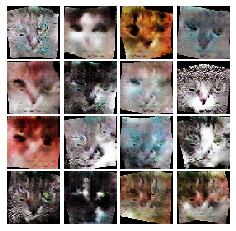


Iter: 10250, D: 0.1304, G:0.2652


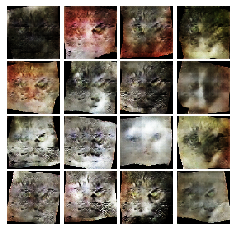


EPOCH:  22
Iter: 10500, D: 0.2391, G:0.2559


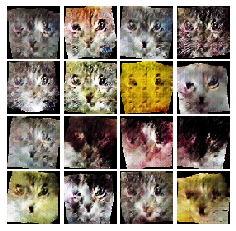


Iter: 10750, D: 0.3295, G:0.4604


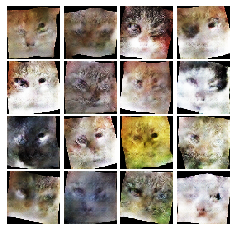


EPOCH:  23
Iter: 11000, D: 0.1882, G:0.2975


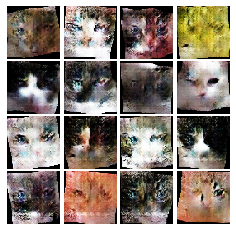


Iter: 11250, D: 0.08587, G:0.3567


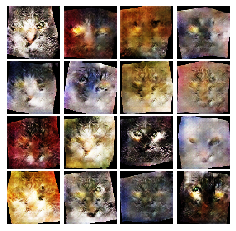


EPOCH:  24
Iter: 11500, D: 0.1624, G:0.5897


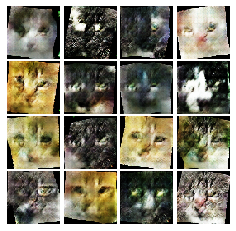


Iter: 11750, D: 0.2822, G:0.3606


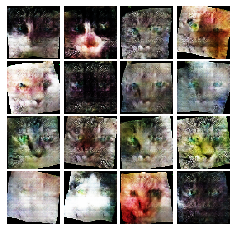


EPOCH:  25
Iter: 12000, D: 0.1341, G:0.4287


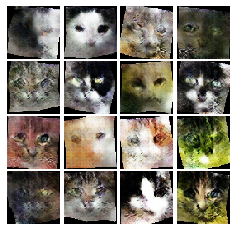


Iter: 12250, D: 0.1234, G:0.5279


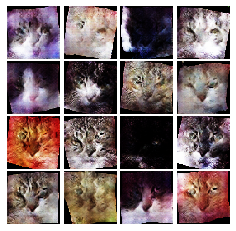


EPOCH:  26
Iter: 12500, D: 0.1036, G:0.4447


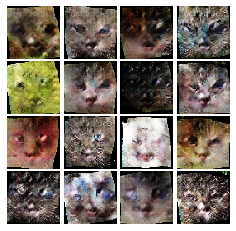


Iter: 12750, D: 0.1939, G:0.2258


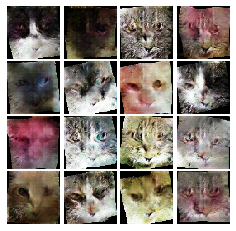


EPOCH:  27
Iter: 13000, D: 0.1137, G:0.4083


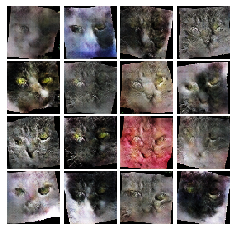


Iter: 13250, D: 0.1493, G:0.3188


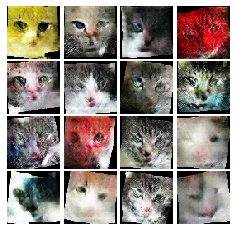


EPOCH:  28
Iter: 13500, D: 0.2537, G:0.193


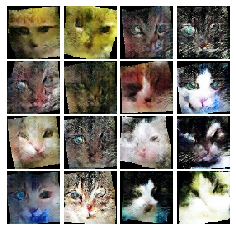


Iter: 13750, D: 0.06797, G:0.4999


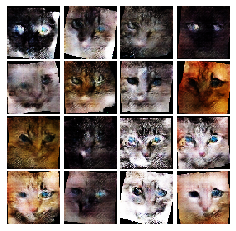


EPOCH:  29
Iter: 14000, D: 0.09172, G:0.4774


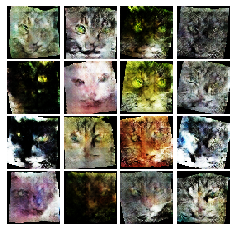


Iter: 14250, D: 0.08619, G:0.5195


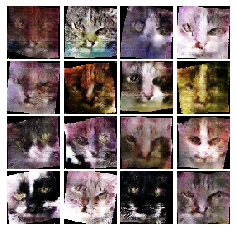


EPOCH:  30
Iter: 14500, D: 0.1735, G:0.2841


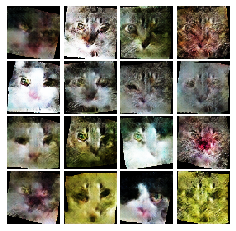


Iter: 14750, D: 0.2195, G:0.9886


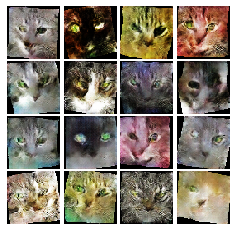


EPOCH:  31
Iter: 15000, D: 0.2585, G:0.2466


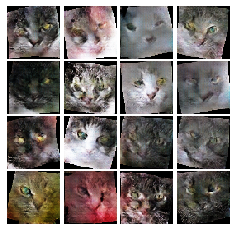


Iter: 15250, D: 0.0963, G:0.4314


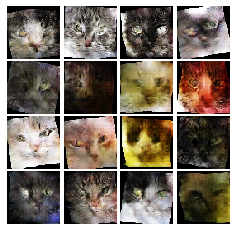


EPOCH:  32
Iter: 15500, D: 0.1162, G:0.2485


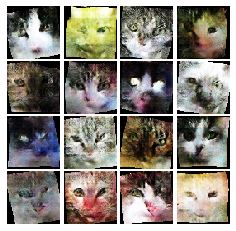


EPOCH:  33
Iter: 15750, D: 0.1191, G:0.3493


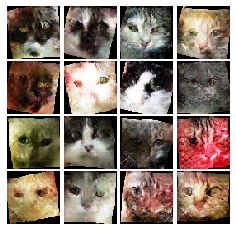


Iter: 16000, D: 0.1024, G:0.7774


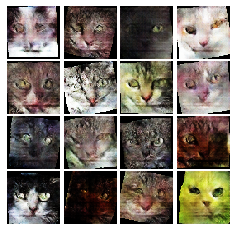


EPOCH:  34
Iter: 16250, D: 0.205, G:0.4655


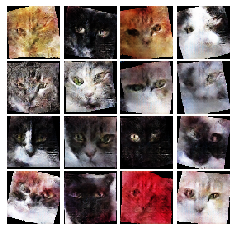


Iter: 16500, D: 0.05756, G:0.4374


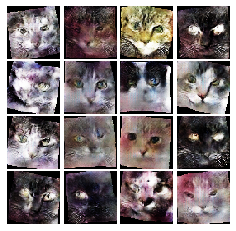


EPOCH:  35
Iter: 16750, D: 0.197, G:0.8755


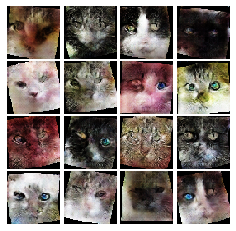


Iter: 17000, D: 0.1101, G:0.4405


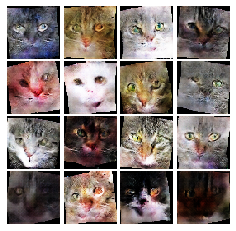


EPOCH:  36
Iter: 17250, D: 0.1753, G:0.6949


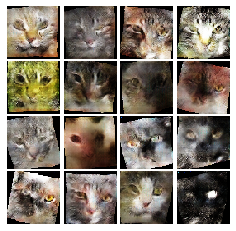


Iter: 17500, D: 0.1252, G:0.3624


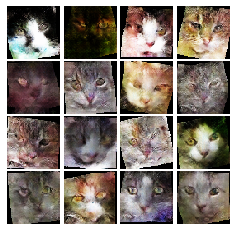


EPOCH:  37
Iter: 17750, D: 0.04155, G:0.6903


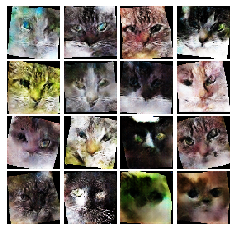


Iter: 18000, D: 0.12, G:0.7802


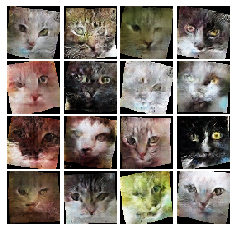


EPOCH:  38
Iter: 18250, D: 0.04781, G:0.4649


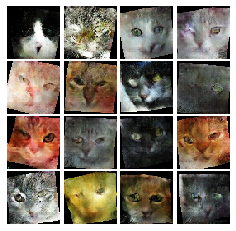


Iter: 18500, D: 0.1144, G:0.4558


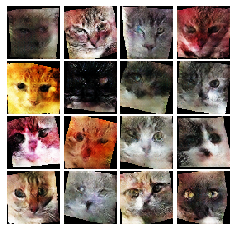


EPOCH:  39
Iter: 18750, D: 0.3456, G:0.37


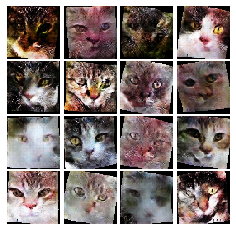


Iter: 19000, D: 0.1028, G:0.5237


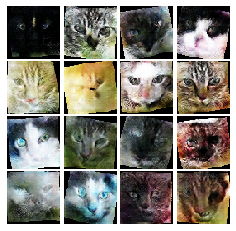


EPOCH:  40
Iter: 19250, D: 0.133, G:0.2134


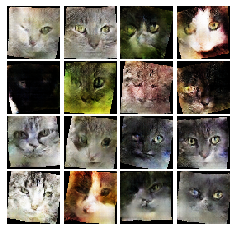


Iter: 19500, D: 0.1004, G:0.6922


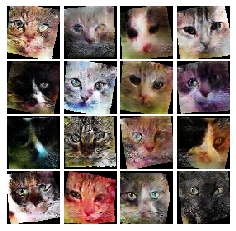


EPOCH:  41
Iter: 19750, D: 0.0526, G:0.4277


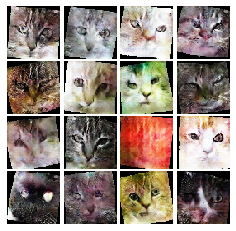


Iter: 20000, D: 0.05978, G:0.3561


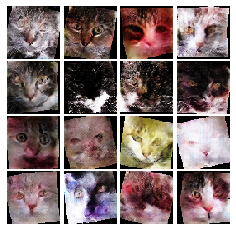


EPOCH:  42
Iter: 20250, D: 0.04712, G:0.546


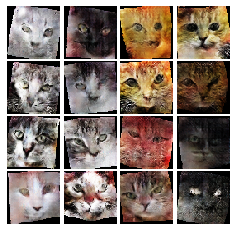


Iter: 20500, D: 0.03552, G:0.4044


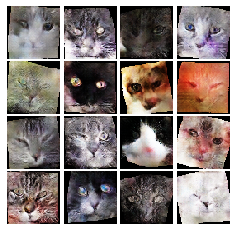


EPOCH:  43
Iter: 20750, D: 0.06767, G:0.5592


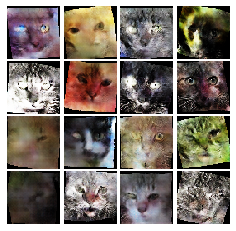


Iter: 21000, D: 0.07736, G:0.4989


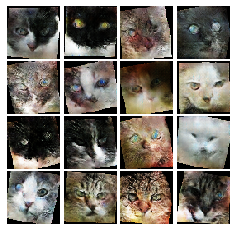


EPOCH:  44
Iter: 21250, D: 0.05759, G:0.5401


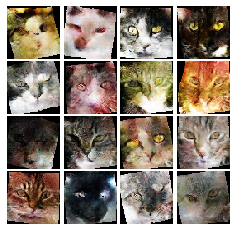


Iter: 21500, D: 0.04354, G:0.5255


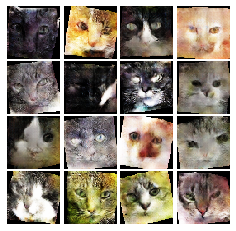


EPOCH:  45
Iter: 21750, D: 0.05283, G:0.2927


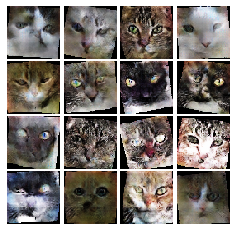


Iter: 22000, D: 0.1165, G:0.4096


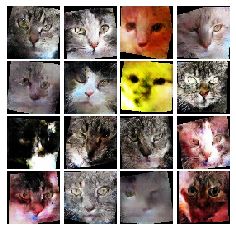


EPOCH:  46
Iter: 22250, D: 0.04187, G:0.4953


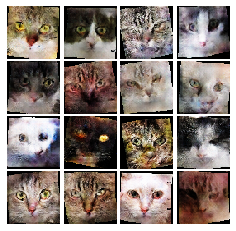


Iter: 22500, D: 0.07277, G:0.4169


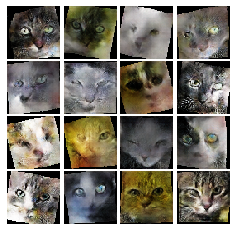


EPOCH:  47
Iter: 22750, D: 0.07707, G:0.5545


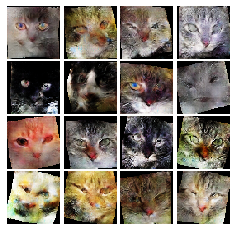


Iter: 23000, D: 0.3742, G:0.2215


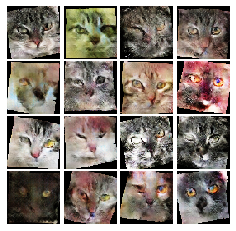


EPOCH:  48
Iter: 23250, D: 0.07377, G:0.6314


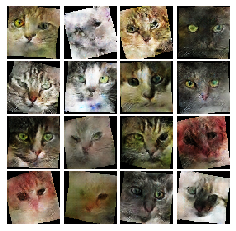


Iter: 23500, D: 0.0584, G:0.3637


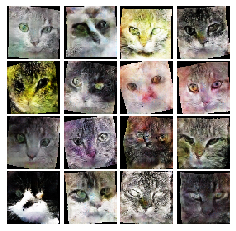


EPOCH:  49
Iter: 23750, D: 0.05824, G:0.4149


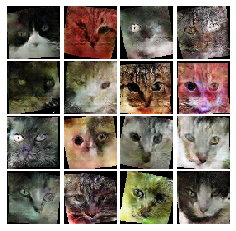


Iter: 24000, D: 0.06263, G:0.4906


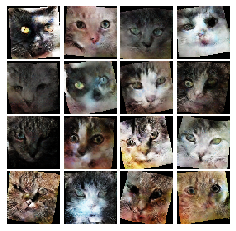


EPOCH:  50
Iter: 24250, D: 0.05168, G:0.5153


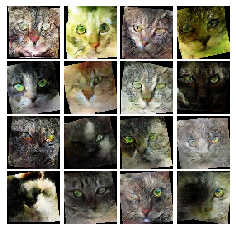


Iter: 24500, D: 0.04949, G:0.7008


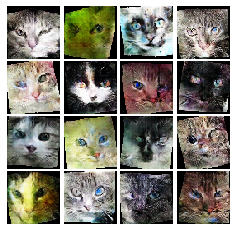

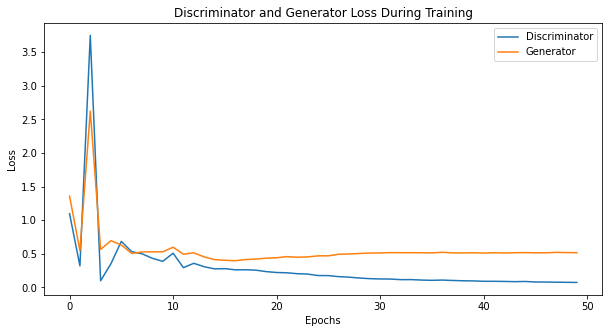

In [23]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

# Focal Loss

In [15]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [16]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [17]:
from gan.losses import discriminator_loss_focal, generator_loss_focal

EPOCH:  1
Iter: 0, D: 0.1438, G:6.555


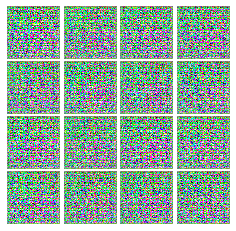


Iter: 250, D: 0.327, G:0.2493


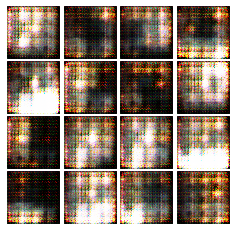


EPOCH:  2
Iter: 500, D: 0.2526, G:0.2106


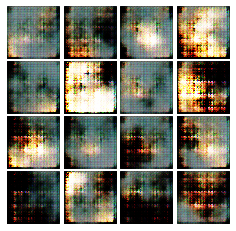


Iter: 750, D: 0.2152, G:0.5519


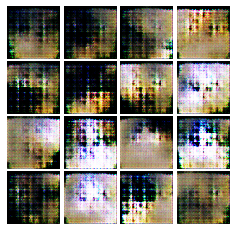


EPOCH:  3
Iter: 1000, D: 0.108, G:0.2058


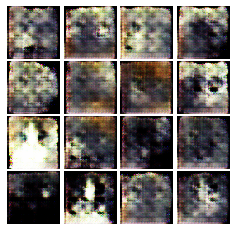


Iter: 1250, D: 0.1566, G:0.193


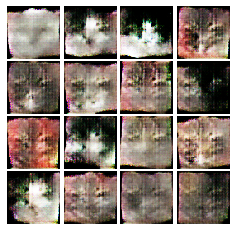


EPOCH:  4
Iter: 1500, D: 0.1415, G:0.1778


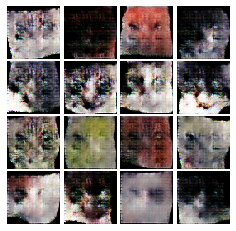


Iter: 1750, D: 0.1459, G:0.2528


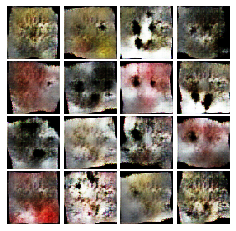


EPOCH:  5
Iter: 2000, D: 0.1311, G:0.1142


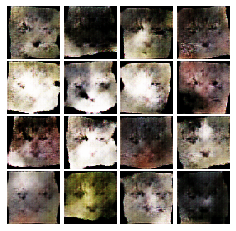


Iter: 2250, D: 0.1607, G:0.1588


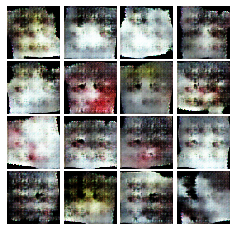


EPOCH:  6
Iter: 2500, D: 0.2282, G:0.1443


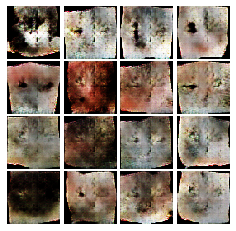


Iter: 2750, D: 0.1135, G:0.1636


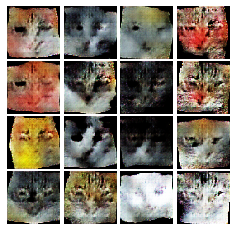


EPOCH:  7
Iter: 3000, D: 0.1769, G:0.198


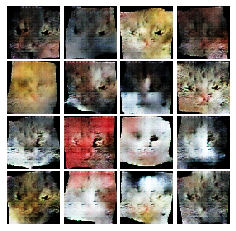


Iter: 3250, D: 0.1161, G:0.155


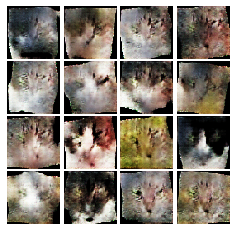


EPOCH:  8
Iter: 3500, D: 0.3022, G:0.2517


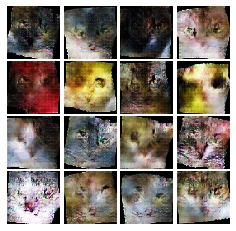


Iter: 3750, D: 0.1302, G:0.3576


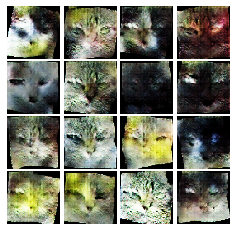


EPOCH:  9
Iter: 4000, D: 0.1517, G:0.2603


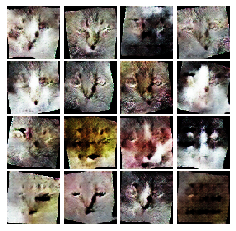


Iter: 4250, D: 0.1341, G:0.1745


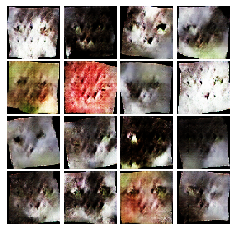


EPOCH:  10
Iter: 4500, D: 0.1483, G:0.2062


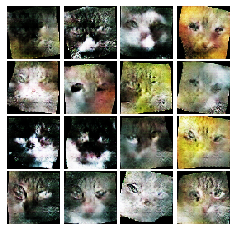


Iter: 4750, D: 0.202, G:0.1598


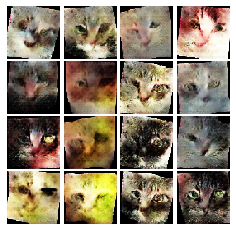


EPOCH:  11
Iter: 5000, D: 0.1998, G:0.2564


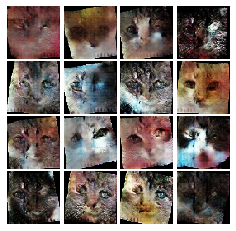


Iter: 5250, D: 0.1319, G:0.1736


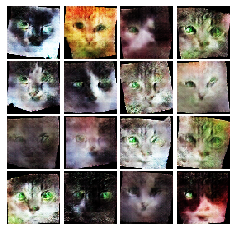


EPOCH:  12
Iter: 5500, D: 0.1025, G:0.1601


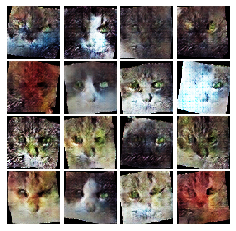


Iter: 5750, D: 0.2741, G:0.3038


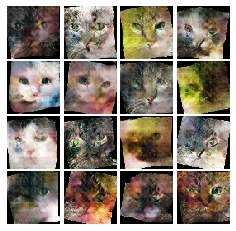


EPOCH:  13
Iter: 6000, D: 0.18, G:0.5848


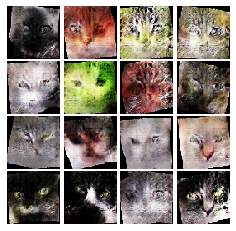


Iter: 6250, D: 0.09868, G:0.2755


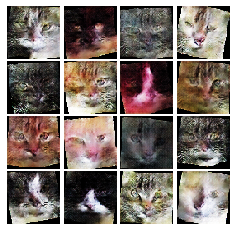


EPOCH:  14
Iter: 6500, D: 0.07511, G:0.2014


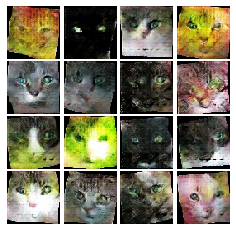


Iter: 6750, D: 0.09084, G:0.1628


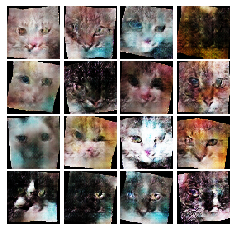


EPOCH:  15
Iter: 7000, D: 0.1247, G:0.2018


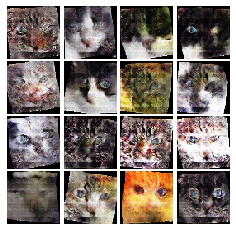


Iter: 7250, D: 0.08307, G:0.2552


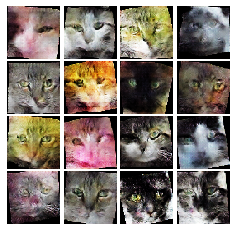


EPOCH:  16
Iter: 7500, D: 0.1962, G:0.4452


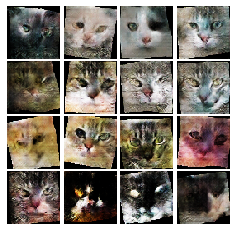


Iter: 7750, D: 0.09766, G:0.236


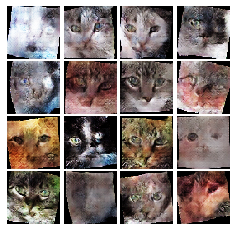


EPOCH:  17
Iter: 8000, D: 0.09361, G:0.2455


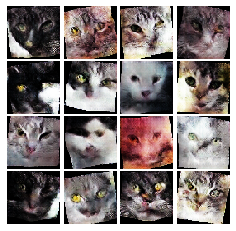


Iter: 8250, D: 0.09794, G:0.1841


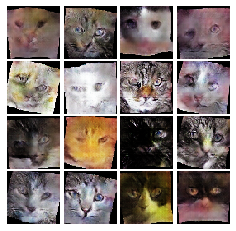


EPOCH:  18
Iter: 8500, D: 0.1341, G:0.2529


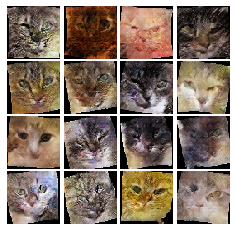


Iter: 8750, D: 0.06686, G:0.295


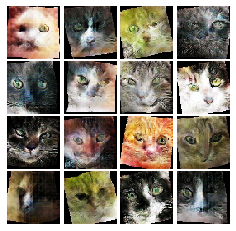


EPOCH:  19
Iter: 9000, D: 0.09237, G:0.2031


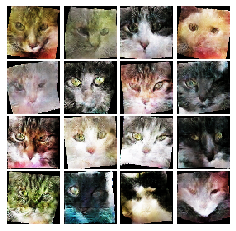


Iter: 9250, D: 0.06188, G:0.2988


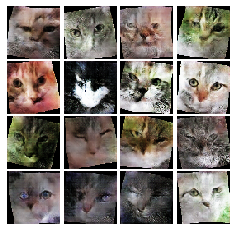


EPOCH:  20
Iter: 9500, D: 0.08963, G:0.2766


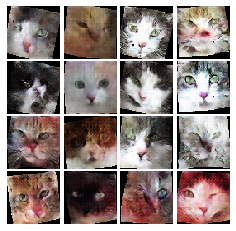


Iter: 9750, D: 0.1213, G:0.2255


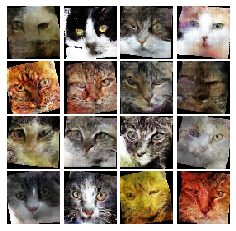


EPOCH:  21
Iter: 10000, D: 0.06465, G:0.4401


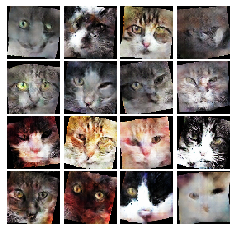


Iter: 10250, D: 0.05082, G:0.3118


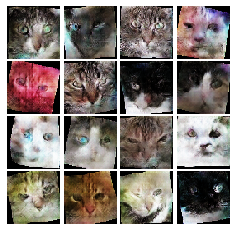


EPOCH:  22
Iter: 10500, D: 0.05414, G:0.2931


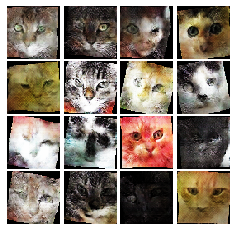


Iter: 10750, D: 0.07354, G:0.4253


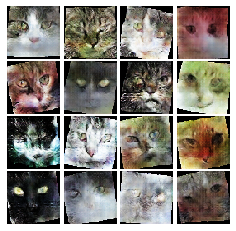


EPOCH:  23
Iter: 11000, D: 0.0624, G:0.5065


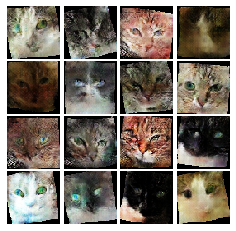


Iter: 11250, D: 0.1983, G:0.2272


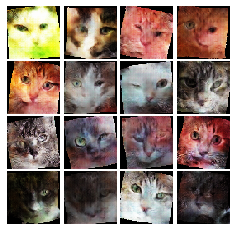


EPOCH:  24
Iter: 11500, D: 0.05721, G:0.3503


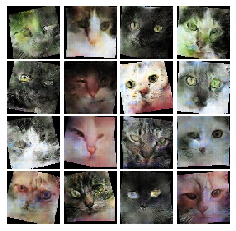


Iter: 11750, D: 0.04186, G:0.3936


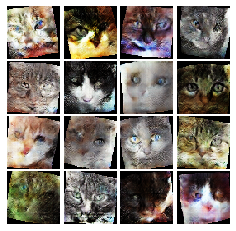


EPOCH:  25
Iter: 12000, D: 0.05056, G:0.2278


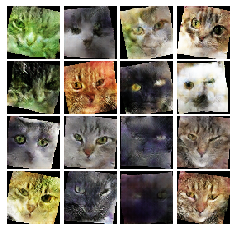


Iter: 12250, D: 0.03451, G:0.4283


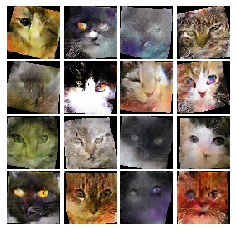


EPOCH:  26
Iter: 12500, D: 0.07259, G:0.4255


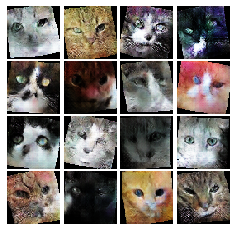


Iter: 12750, D: 0.2151, G:1.249


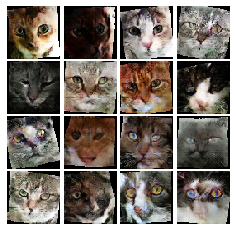


EPOCH:  27
Iter: 13000, D: 0.04858, G:0.4474


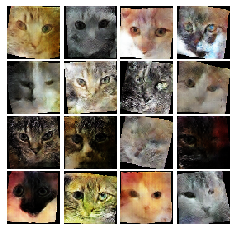


Iter: 13250, D: 0.06086, G:0.317


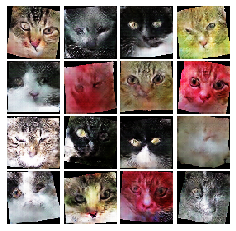


EPOCH:  28
Iter: 13500, D: 0.07225, G:0.7038


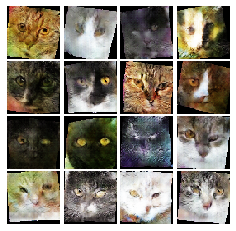


Iter: 13750, D: 0.02255, G:0.4406


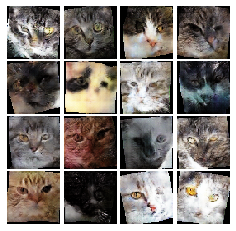


EPOCH:  29
Iter: 14000, D: 0.04232, G:0.7


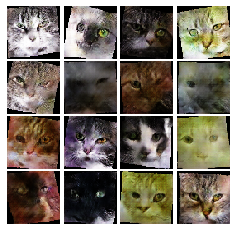


Iter: 14250, D: 0.02643, G:0.4083


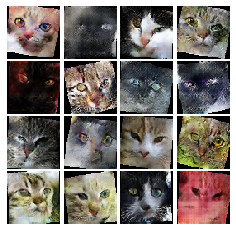


EPOCH:  30
Iter: 14500, D: 0.01589, G:0.6657


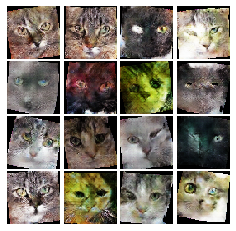


Iter: 14750, D: 0.08266, G:1.222


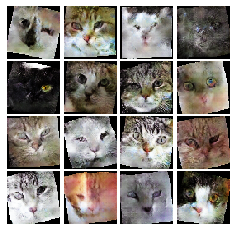


EPOCH:  31
Iter: 15000, D: 0.02361, G:0.4544


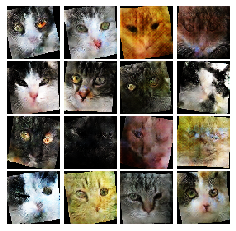


Iter: 15250, D: 0.06408, G:0.7446


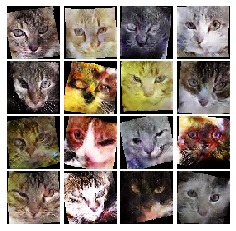


EPOCH:  32
Iter: 15500, D: 0.03832, G:0.4002


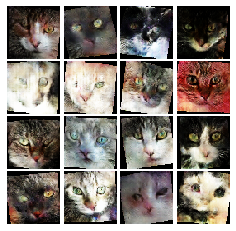


EPOCH:  33
Iter: 15750, D: 0.1736, G:0.4445


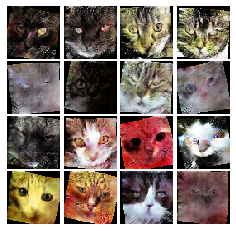


Iter: 16000, D: 0.008464, G:0.486


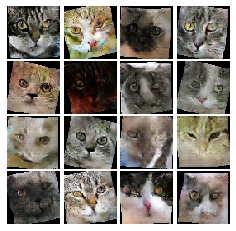


EPOCH:  34
Iter: 16250, D: 0.02206, G:0.5092


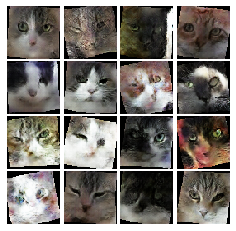


Iter: 16500, D: 0.03441, G:0.6719


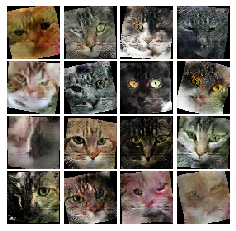


EPOCH:  35
Iter: 16750, D: 0.02162, G:0.2467


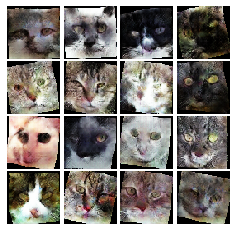


Iter: 17000, D: 0.01365, G:0.4336


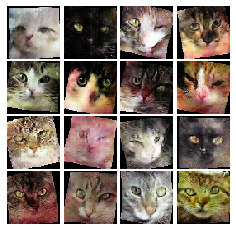


EPOCH:  36
Iter: 17250, D: 0.04934, G:0.3799


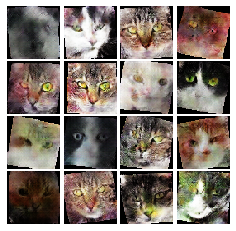


Iter: 17500, D: 0.03389, G:0.8186


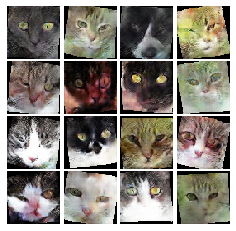


EPOCH:  37
Iter: 17750, D: 0.01999, G:0.4517


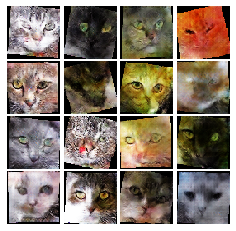


Iter: 18000, D: 0.05221, G:0.5328


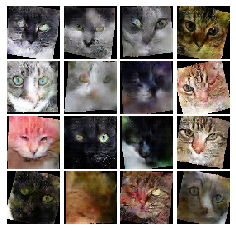


EPOCH:  38
Iter: 18250, D: 0.02868, G:0.4832


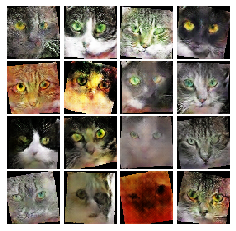


Iter: 18500, D: 0.05047, G:0.5003


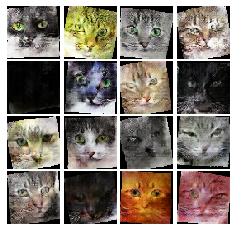


EPOCH:  39
Iter: 18750, D: 0.08532, G:0.7166


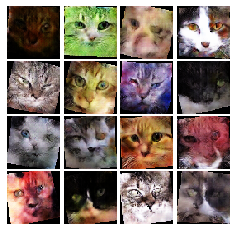


Iter: 19000, D: 0.02868, G:0.5283


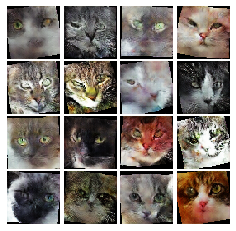


EPOCH:  40
Iter: 19250, D: 0.01146, G:0.4257


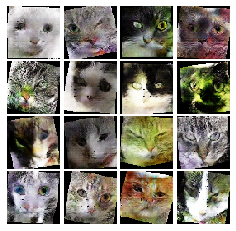


Iter: 19500, D: 0.01091, G:0.4408


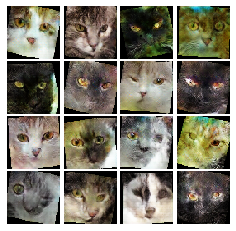


EPOCH:  41
Iter: 19750, D: 0.06085, G:0.4164


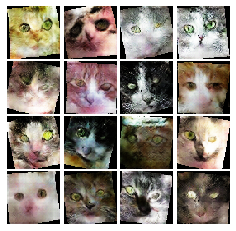


Iter: 20000, D: 0.0747, G:0.9636


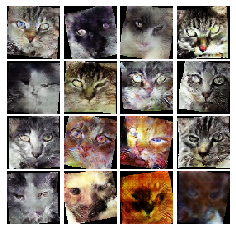


EPOCH:  42
Iter: 20250, D: 0.009813, G:0.5684


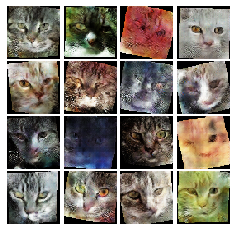


Iter: 20500, D: 0.03866, G:0.79


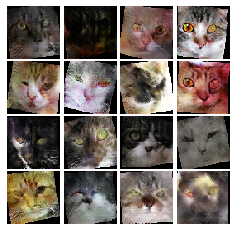


EPOCH:  43
Iter: 20750, D: 0.01629, G:0.5113


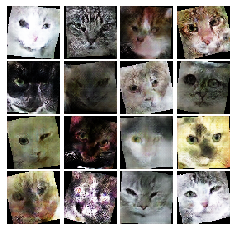


Iter: 21000, D: 0.02227, G:0.5146


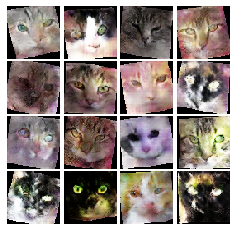


EPOCH:  44
Iter: 21250, D: 0.06649, G:0.8492


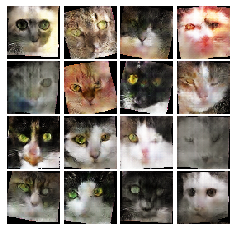


Iter: 21500, D: 0.02172, G:0.8006


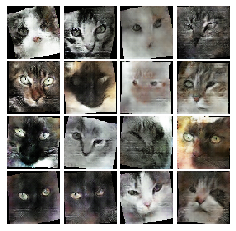


EPOCH:  45
Iter: 21750, D: 0.08795, G:0.7147


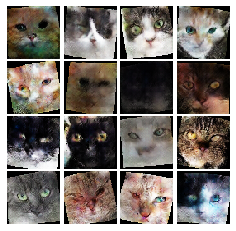


Iter: 22000, D: 0.01393, G:0.7414


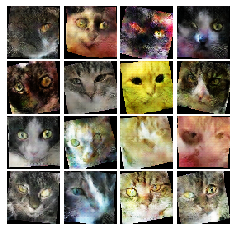


EPOCH:  46
Iter: 22250, D: 0.00843, G:0.5748


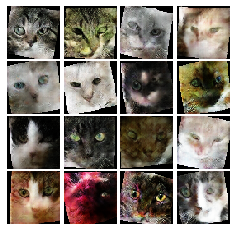


Iter: 22500, D: 0.01848, G:0.5136


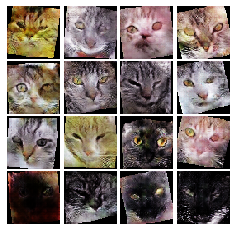


EPOCH:  47
Iter: 22750, D: 0.333, G:2.586


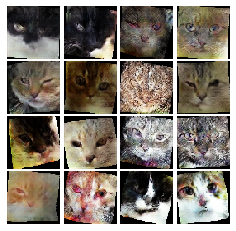


Iter: 23000, D: 0.01226, G:0.5888


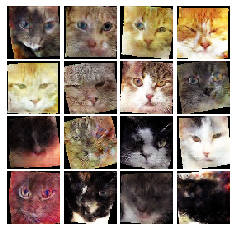


EPOCH:  48
Iter: 23250, D: 0.6705, G:0.6809


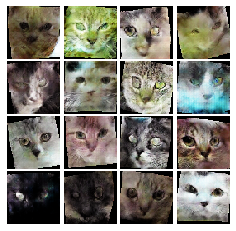


Iter: 23500, D: 0.1109, G:1.446


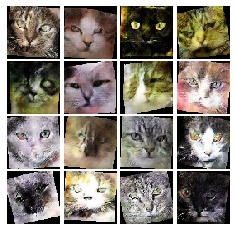


EPOCH:  49
Iter: 23750, D: 0.04184, G:0.9245


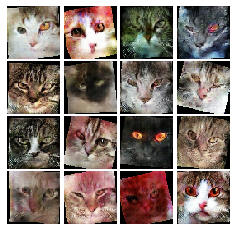


Iter: 24000, D: 0.05974, G:0.6356


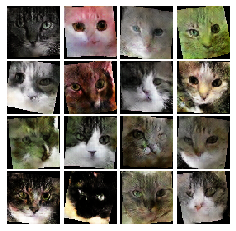


EPOCH:  50
Iter: 24250, D: 0.05043, G:0.3641


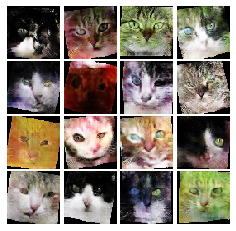


Iter: 24500, D: 0.008565, G:0.4223


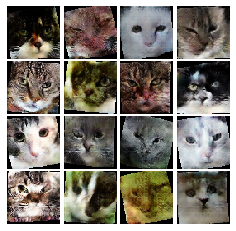

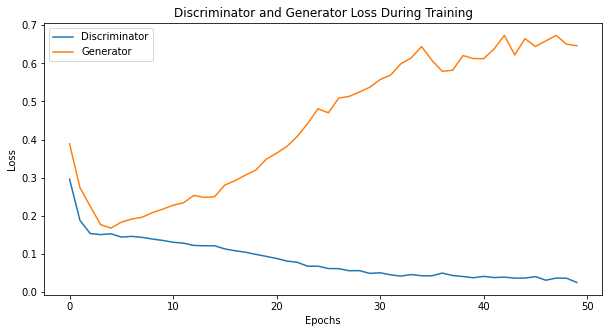

In [20]:
# original gan
focal_loss_fn = FocalLoss(gamma=2, alpha=0.25, size_average=True)

# Pass the focal loss function properly
train(
    D=D,
    G=G,
    D_solver=D_optimizer,
    G_solver=G_optimizer,
    discriminator_loss=lambda logits_real, logits_fake: discriminator_loss_focal(logits_real, logits_fake, focal_loss_fn),
    generator_loss=lambda logits_fake: generator_loss_focal(logits_fake, focal_loss_fn),
    num_epochs=NUM_EPOCHS,
    show_every=250,
    batch_size=batch_size,
    train_loader=cat_loader_train,
    device=device
)

In [19]:
import torch
import torch.nn as nn
import torch.nn.functional as F
class FocalLoss(nn.Module):
    def __init__(self, gamma=5, alpha=1, size_average=True):
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        self.alpha = alpha
        if isinstance(alpha, (float, int)):  # support for scalar alpha
            self.alpha = torch.tensor([alpha, 1-alpha], dtype=torch.float32)
        elif isinstance(alpha, list):
            self.alpha = torch.tensor(alpha, dtype=torch.float32)
        self.size_average = size_average

    def forward(self, inputs, targets):
        # Ensure we're working with float32 for consistency
        inputs = inputs.type_as(targets)
        
        # Calculate the probability of being classified as class '1'
        probs = torch.sigmoid(inputs)
        # Calculate the binary cross entropy loss without reduction
        bce_loss = F.binary_cross_entropy_with_logits(inputs, targets, reduction='none')

        # Here we adjust the targets to be either alpha or 1-alpha based on their class
        alpha_factor = torch.where(targets == 1, self.alpha[0], self.alpha[1])
        alpha_factor = alpha_factor.type_as(probs)

        # Modulate the loss with the focusing parameter
        focal_weight = torch.where(targets == 1, 1 - probs, probs)
        focal_weight = alpha_factor * (focal_weight ** self.gamma)

        # Apply focal weight to BCE loss
        focal_loss = focal_weight * bce_loss

        # Average the loss if size_average is true
        if self.size_average:
            return focal_loss.mean()
        else:
            return focal_loss.sum()